In [ ]:
import numpy as np
import cv2
from google.colab.patches import cv2_imshow
from PIL import Image, ImageChops
import matplotlib.pyplot as plt


Denoising Images using averaging multiple images.

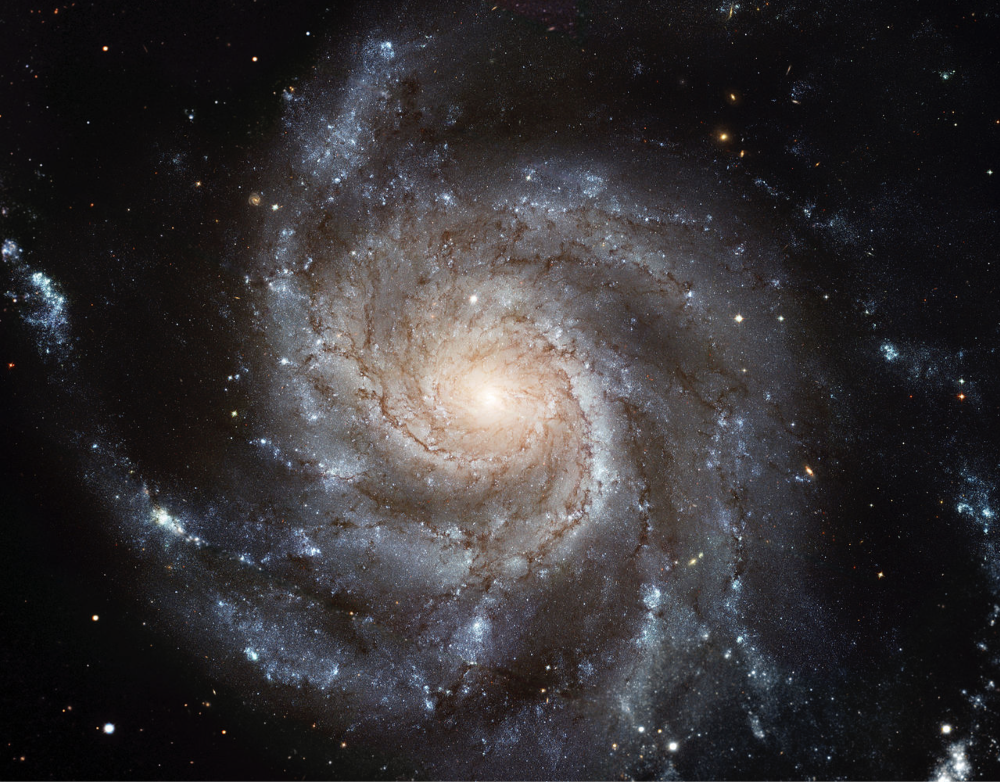

(1782, 2278, 3)


In [ ]:
# Loading the images
galaxy = cv2.imread('Galaxy2.jpg')
cv2_imshow(galaxy)
print(galaxy.shape)

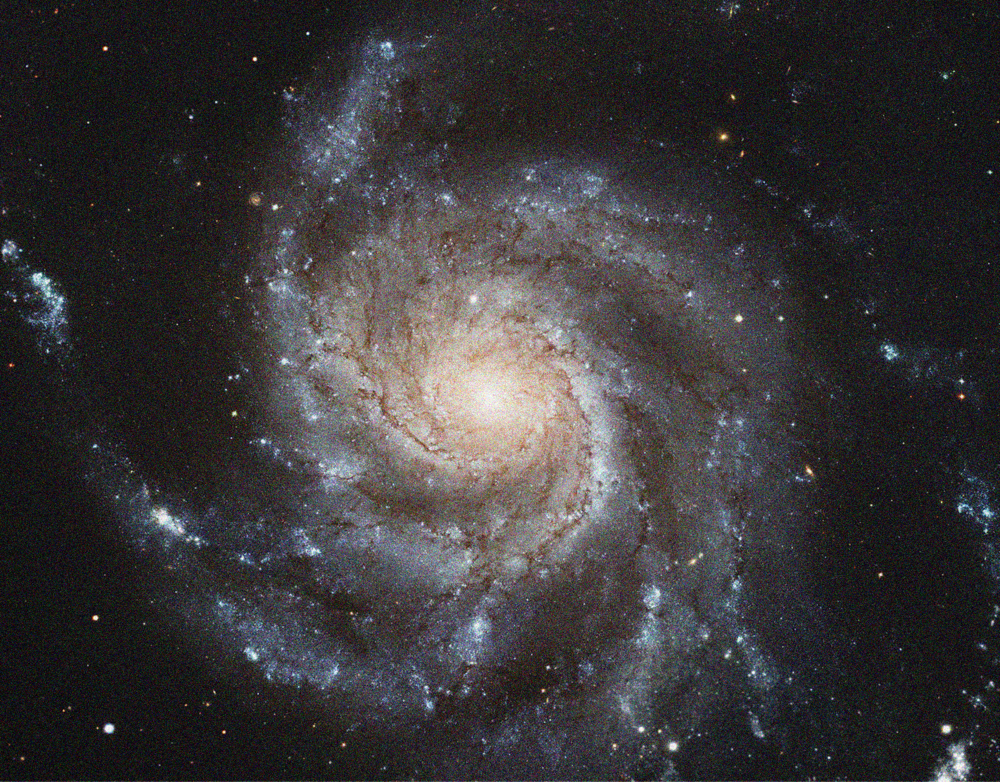

In [ ]:
# Generating Gaussian Noise
row, col, ch = galaxy.shape
mean = 0
var = 0.11
sigma = 400 * var

gaussian_noise = np.random.normal(mean, sigma, (row,col,ch))
gaussian_noise.reshape(row, col, ch)

# Noisy Image
noisy_galaxy = galaxy + gaussian_noise
cv2_imshow(noisy_galaxy)

In [ ]:
 # Averaging noisy images
 n_image = [5,10,20,50,100]

 for n in n_image:
    image_averages = []
    iter = 0
    while iter < n:
        gaussian_noise = np.random.normal(mean,sigma,(row,col,ch))
        gaussian_noise.reshape(row, col, ch)
        noisy_galaxy = galaxy + gaussian_noise
        image_averages.append(noisy_galaxy)
        iter+=1

    denoised_image = np.zeros((row,col,ch))
    for avg in image_averages:
        denoised_image = denoised_image + avg
    denoised_image = denoised_image / n
    print("Averaging ",n," images")
    cv2_imshow(denoised_image)

Image Luminance balancing using Subtraction

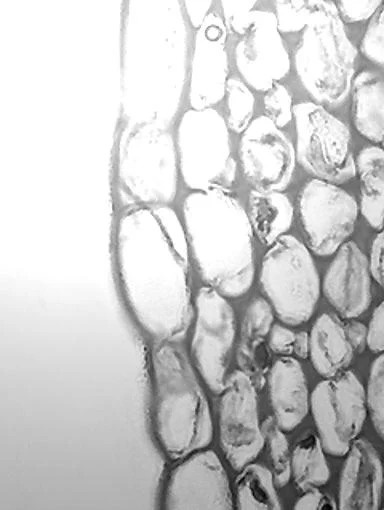

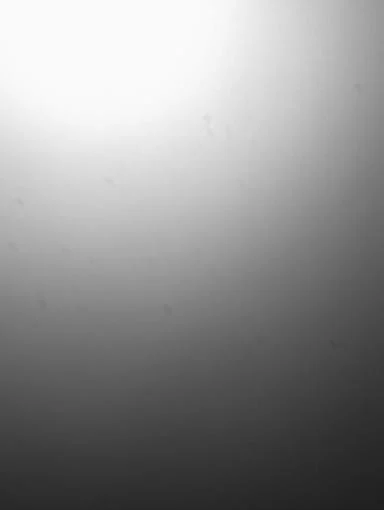

In [ ]:
# Loading uneven luminance image
mask_image = cv2.imread('luminance_correction.jpg')
correction = cv2.imread('luminance_correction_2.jpg')

cv2_imshow(mask_image)
cv2_imshow(correction)

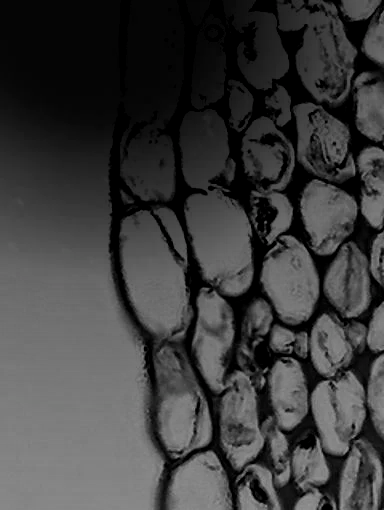

In [ ]:
balanced_image = cv2.subtract(mask_image, correction)
cv2_imshow(balanced_image)

Multiplying Images for Masking

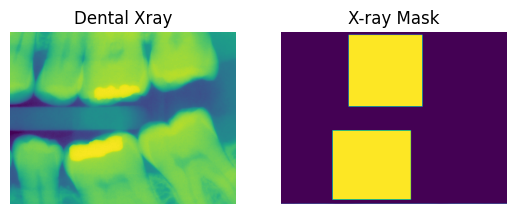

In [ ]:
dental_xray = Image.open('dental_xray.tif')
xray_mask = Image.open('x-ray_mask.tif')

plt.subplot(1,2,1)
plt.axis('off')
plt.title('Dental Xray')
plt.imshow(dental_xray)

plt.subplot(1,2,2)
plt.axis('off')
plt.title('X-ray Mask')
plt.imshow(xray_mask)



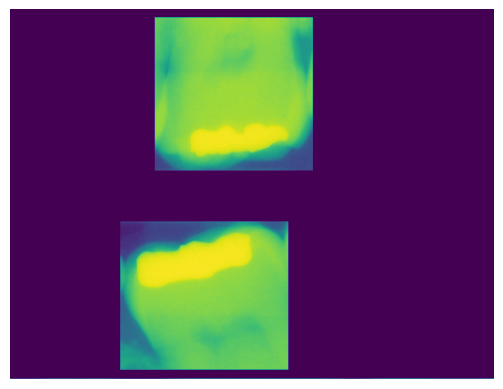

In [ ]:
# Multiplying the images
masking = ImageChops.multiply(dental_xray, xray_mask)
plt.axis('off')
plt.imshow(masking)
